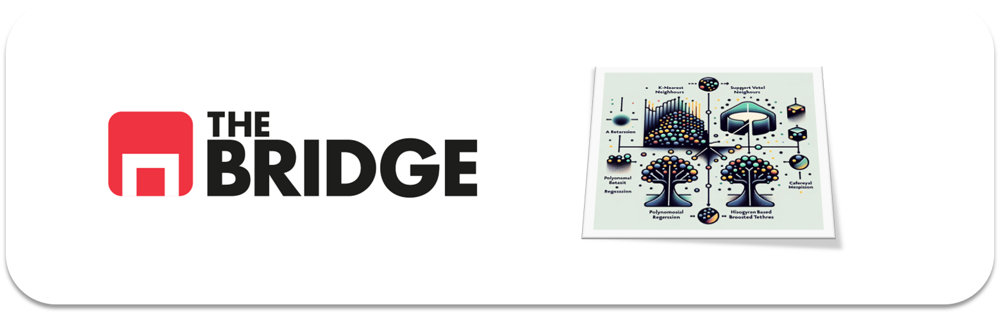

* La práctica consiste en resolver sobre un mismo dataset un problema de clasificación y un problema de regresión.

### Ejercicio 0

Importa los paquetes y módulos que necesites a lo largo del notebook.

In [1]:
import pandas as pd
import numpy as np
import scipy
import sklearn
from sklearn.metrics import *


In [2]:
# Librerías gráficas
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import plotly.graph_objects as go
import plotly.express as px

In [3]:
#Configuraciones
import matplotlib.colors as mpl_colors
def hex_to_rgb(h):
    h = h.lstrip('#')
    return tuple(int(h[i:i+2], 16)/255 for i in (0, 2, 4))

palette = ['#b4d2b1', '#568f8b', '#1d4a60', '#cd7e59', '#ddb247', '#d15252']
palette_rgb = [hex_to_rgb(x) for x in palette]
cmap = mpl_colors.ListedColormap(palette_rgb)
colors = cmap.colors
bg_color= '#fdfcf6'

custom_params = {
    "axes.spines.right": False,
    "axes.spines.top": False,
    'grid.alpha':0.3,
    'figure.figsize': (16, 6),
    'axes.titlesize': 'Large',
    'axes.labelsize': 'Large',
    'figure.facecolor': bg_color,
    'axes.facecolor': bg_color
}

sns.set_theme(
    style='whitegrid',
    palette=sns.color_palette(palette),
    rc=custom_params
)



In [4]:
# Funciones
import os
import sys
utils_path = r'C:\Users\0205301\OneDrive - SENER\Documentos\GitHub\EDAMOTO\src\utils'
sys.path.append(utils_path)
from utils import *

In [5]:
def reduce_memory_usage(df, verbose=True):
    numerics = ["int8", "int16", "int32", "int64", "float16", "float32", "float64"]
    start_mem = df.memory_usage().sum() / 1024 ** 2
    # Excluir las columnas de índice
    columns_to_exclude = df.index.names if df.index.name else []
    for col in df.columns:
        if col in columns_to_exclude:
            continue
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == "int":
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)
            else:
                if (
                    c_min > np.finfo(np.float16).min
                    and c_max < np.finfo(np.float16).max
                ):
                    df[col] = df[col].astype(np.float16)
                elif (
                    c_min > np.finfo(np.float32).min
                    and c_max < np.finfo(np.float32).max
                ):
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
    end_mem = df.memory_usage().sum() / 1024 ** 2
    if verbose:
        print(
            "Mem. usage decreased to {:.2f} Mb ({:.1f}% reduction)".format(
                end_mem, 100 * (start_mem - end_mem) / start_mem
            )
        )
    return df



In [6]:
#switch off the warnings
import warnings
warnings.filterwarnings('ignore')

### #1 Explicación del dataset y carga de datos

Vamos a trabajar con el dataset "Wine Quality", que es un dataset en el que se recogen diversas características fisicoquímicas de las variades tinta y blanca del "Vinho verde" portugués. Las variables del dataset se describen a continuación


1. **Acidez fija**: La mayoría de los ácidos involucrados con el vino son fijos o no volátiles (no se evaporan fácilmente).
2. **Acidez volátil**: La cantidad de ácido acético en el vino, que en niveles demasiado altos puede llevar a un sabor desagradable a vinagre.
3. **Ácido cítrico**: Encontrado en pequeñas cantidades, el ácido cítrico puede añadir 'frescura' y sabor a los vinos.
4. **Azúcar residual**: Es la cantidad de azúcar restante después de que se detiene la fermentación, es raro encontrar vinos con menos de 1 gramo/litro y vinos con más de 45 gramos/litro se consideran dulces.
5. **Cloruros**: La cantidad de sal en el vino.
6. **Dióxido de azufre libre**: La porción libre de SO2 existe en equilibrio entre el SO2 molecular (como un gas disuelto) y el ion bisulfito; previene el crecimiento microbiano y la oxidación del vino.
7. **Dióxido de azufre total**: Es la cantidad de formas libres y ligadas de S02; en bajas concentraciones, el SO2 es en su mayoría indetectable en el vino, pero en concentraciones libres de más de 50 ppm, el SO2 se hace evidente en la nariz y el sabor del vino.
8. **Densidad**: La densidad del vino es cercana a la del agua dependiendo del porcentaje de alcohol y contenido de azúcar.
9. **pH**: Describe qué tan ácido o básico es un vino en una escala de 0 (muy ácido) a 14 (muy básico); la mayoría de los vinos están entre 3-4 en la escala de pH.
10. **Sulfatos**: Un aditivo del vino que puede contribuir a los niveles de dióxido de azufre (SO2), que actúa como un antimicrobiano y antioxidante.
11. **Alcohol**: El porcentaje de contenido de alcohol del vino.
12. **Calidad**: Una variable de salida (basada en datos sensoriales, puntuación entre 0 y 10).
13. **Class**: Si es blanco o tinto.



Carga el dataset "wines_dataset.csv", muestra sus primeras filas, su información general y define dos variables target una para clasificación que permita predecir la calidad del vino según el resto de propiedas y otra variable target para regresión que permita predecir el grado alcohólico del vino a partir del resto de propiedades. 

El **objetivo de negocio en el primer problema** será anticipar la posible clasificación de sus vinos por los catadores profesionales y a partir de ahí poder planificar la producción, distribución y precio a poner a cada vino. En este sentido, el "cliente" nos dice que le gustaría poder clasificar correctamente lo mejor posible en media  (que interpretamos como el mejor recall medio posible).

El **objetivo de negocio en el segundo problema** (bastante artificial) es poder hacer simulaciones de posibles vinos futuros para saber cómo conseguir variedades más o menos alcohólicas para atender mercados diferentes. En este sentido, les interesa equivocarse lo menos posible porcentualmente sobre el grado alochólico real.

NOTA: El dataset está limpio y sin valores faltantes.

In [7]:
# carga de datos
df=pd.read_csv('./datasets/wines_dataset.csv',sep="|")

In [8]:
#Finding the duplicates from dataset...
df.duplicated().sum()
#Removing all the duplicated records
df.drop_duplicates(inplace=True)

# 1 Análisis EDA

In [9]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,class
0,8.5,0.21,0.26,9.25,0.034,73.0,142.0,0.99450,3.05,0.37,11.4,6,white
1,8.3,0.16,0.37,7.90,0.025,38.0,107.0,0.99306,2.93,0.37,11.9,6,white
2,6.8,0.18,0.38,1.40,0.038,35.0,111.0,0.99180,3.32,0.59,11.2,7,white
3,6.1,0.26,0.25,2.90,0.047,289.0,440.0,0.99314,3.44,0.64,10.5,3,white
4,7.5,0.63,0.27,2.00,0.083,17.0,91.0,0.99616,3.26,0.58,9.8,6,red


In [10]:
df.tail()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,class
6488,8.2,0.43,0.29,1.6,0.081,27.0,45.0,0.99603,3.25,0.54,10.3,5,red
6490,6.5,0.24,0.29,8.2,0.043,32.0,156.0,0.99453,3.13,0.70,10.1,6,white
6492,7.7,0.39,0.34,10.0,0.056,35.0,178.0,0.99740,3.26,0.60,10.2,5,white
6494,7.4,0.31,0.48,14.2,0.042,62.0,204.0,0.99830,3.06,0.59,9.4,5,white
6496,8.4,0.67,0.19,2.2,0.093,11.0,75.0,0.99736,3.20,0.59,9.2,4,red


In [11]:
df.shape

(5320, 13)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 5320 entries, 0 to 6496
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         5320 non-null   float64
 1   volatile acidity      5320 non-null   float64
 2   citric acid           5320 non-null   float64
 3   residual sugar        5320 non-null   float64
 4   chlorides             5320 non-null   float64
 5   free sulfur dioxide   5320 non-null   float64
 6   total sulfur dioxide  5320 non-null   float64
 7   density               5320 non-null   float64
 8   pH                    5320 non-null   float64
 9   sulphates             5320 non-null   float64
 10  alcohol               5320 non-null   float64
 11  quality               5320 non-null   int64  
 12  class                 5320 non-null   object 
dtypes: float64(11), int64(1), object(1)
memory usage: 581.9+ KB


In [13]:
df.isna().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
class                   0
dtype: int64

In [14]:
print("Calidad del vino",sorted(df['quality'].unique()))

Calidad del vino [3, 4, 5, 6, 7, 8, 9]


## Análisis univariante

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats

def feat_plot(feature):
    plt.figure(figsize=(16, 6))
    
    # Histogram plot
    plt.subplot(1, 3, 1)
    feature.plot(kind='hist', bins=20, alpha=0.7)
    plt.title(f'{feature.name} histogram plot')
    
    # Density plot
    plt.subplot(1, 3, 2)
    sns.histplot(feature, kde=True, color='blue')
    plt.title(f'{feature.name} distribution plot')
    
    # Box plot
    plt.subplot(1, 3, 3)
    sns.boxplot(x=feature)
    plt.title(f'{feature.name} box plot')
    
    plt.tight_layout()
    plt.show()



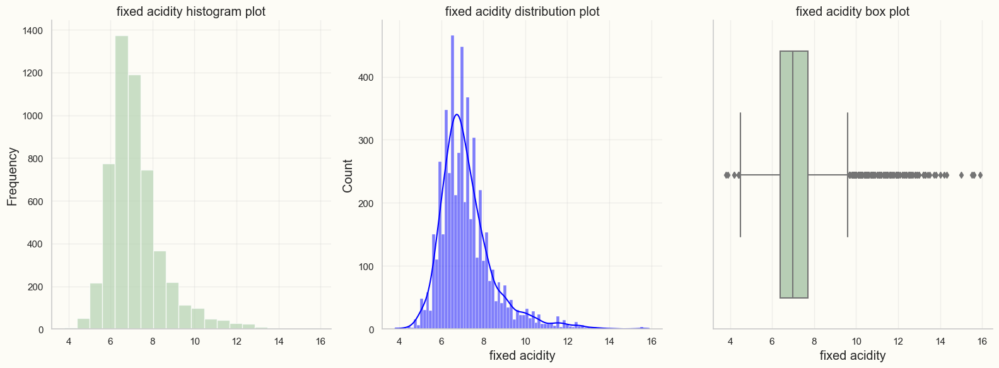

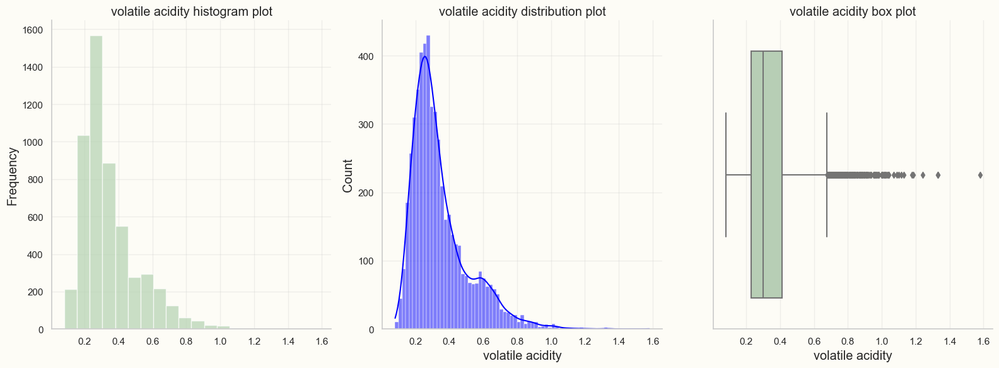

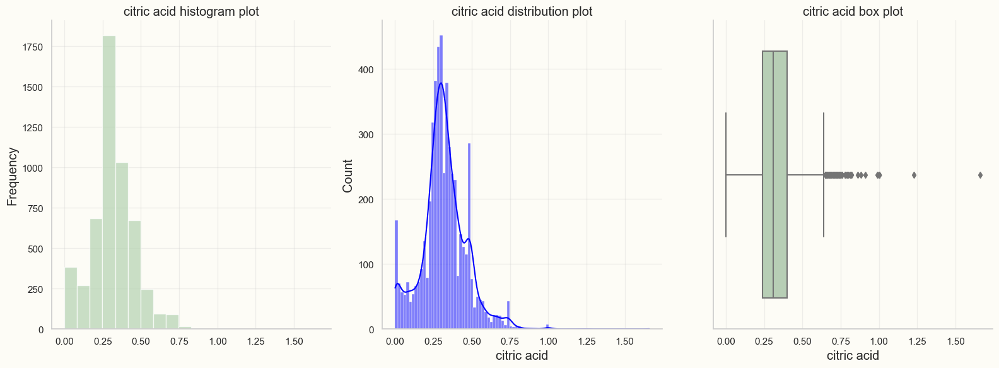

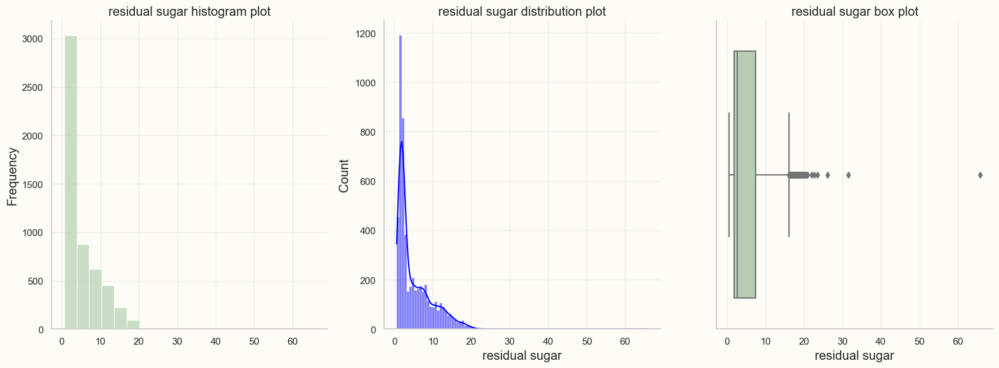

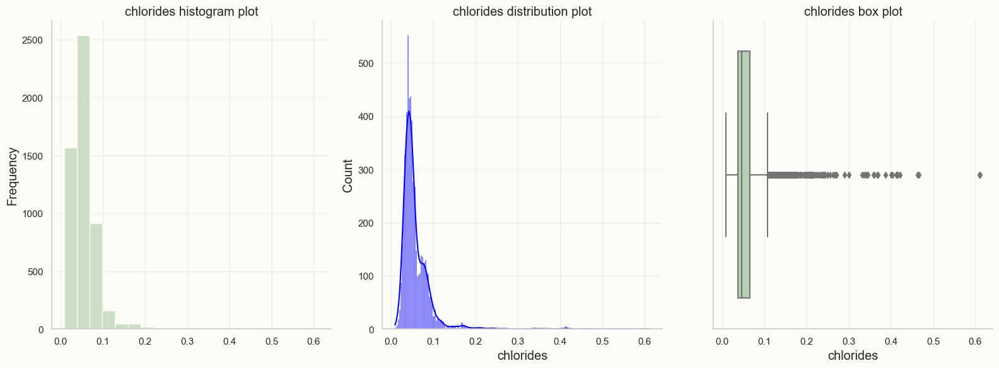

...

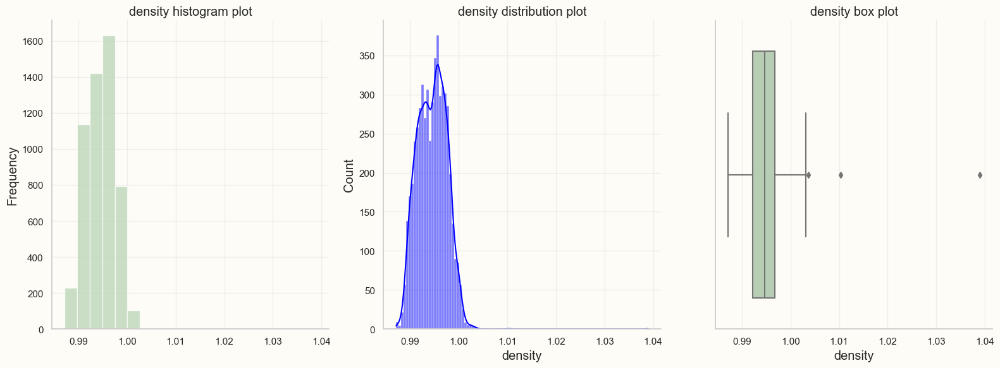

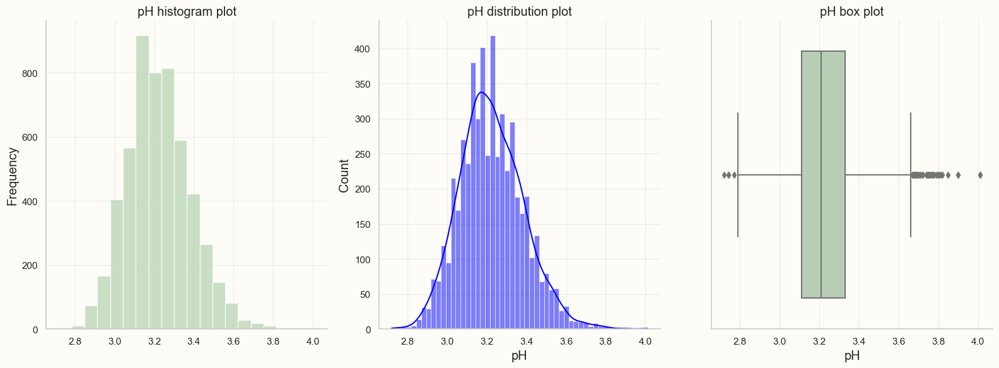

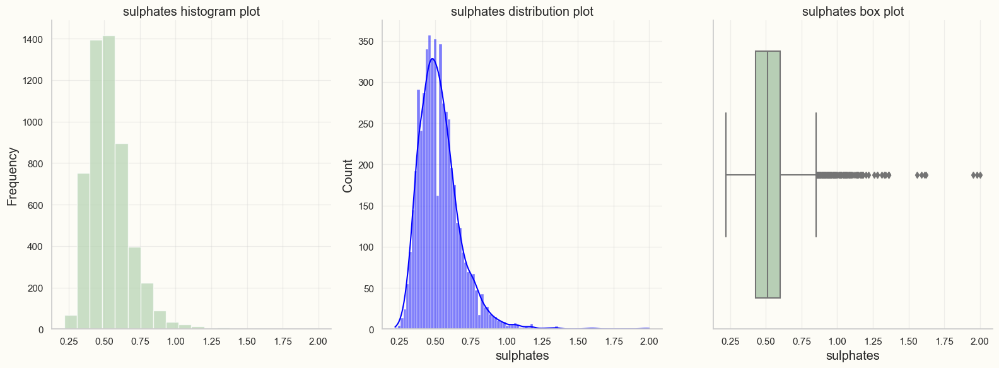

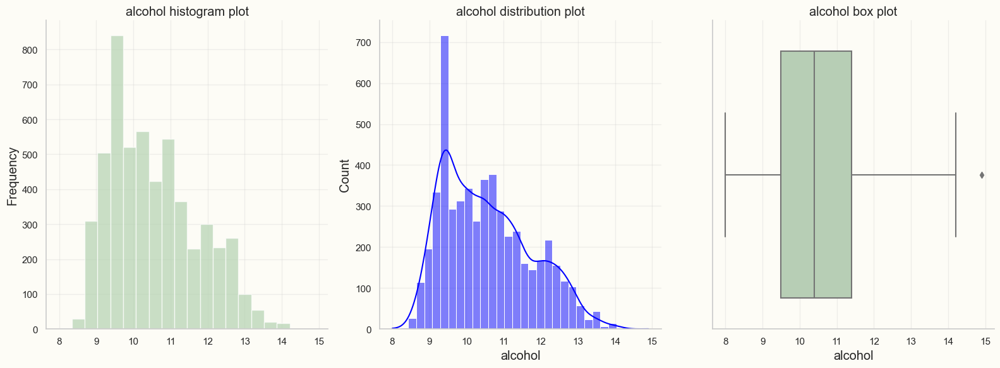

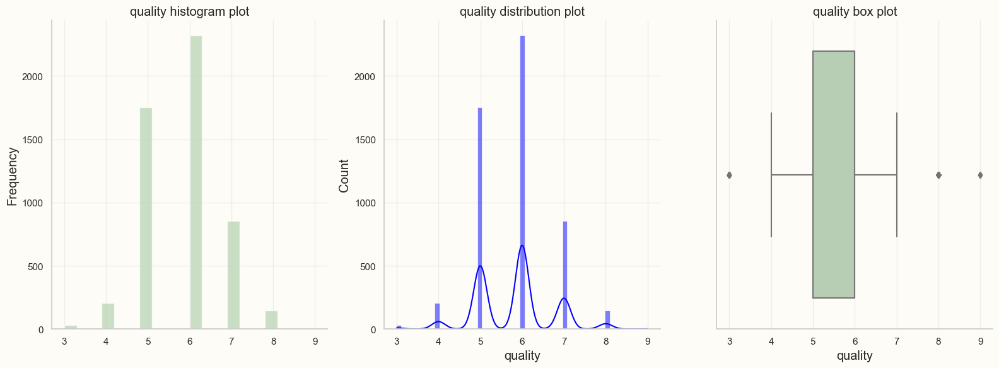

In [16]:
num_cols = df.select_dtypes(include = 'number').columns
for col in num_cols:
    feat_plot(df[col])

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm

def plot_analysis(data, target, col):
    col_mean = []

    for each in df[target].unique():
        x = data[data[target] == each]
        mean = x[col].mean()
        col_mean.append(mean)

    plt.figure(figsize=(8,6))
    plt.subplot(2,2,1)
    plt.hist(data[col], color="lightgreen")
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.title(f"{col} histogram", color="black", fontweight='bold', fontsize=6)
    
    plt.subplot(2,2,2)
    sns.distplot(data[col], fit=norm, color="green")
    plt.title(f"{col} Distplot", color="black", fontweight='bold', fontsize=6)
    
    plt.subplot(2,2,3)
    sns.barplot(x=df[target].unique(), y=col_mean, palette="Greens")
    plt.title(f"The average value of {col} by {target}", color="black", fontweight='bold', fontsize=6)
    plt.xlabel(target)
    plt.ylabel(f"{col} mean")
    
    plt.subplot(2,2,4)
    sns.boxplot(x=data[target], y=data[col], palette='Greens') 
    plt.title(f"{col} & {target}", color="black", fontweight='bold', fontsize=6)
    
    plt.tight_layout()
    plt.show()




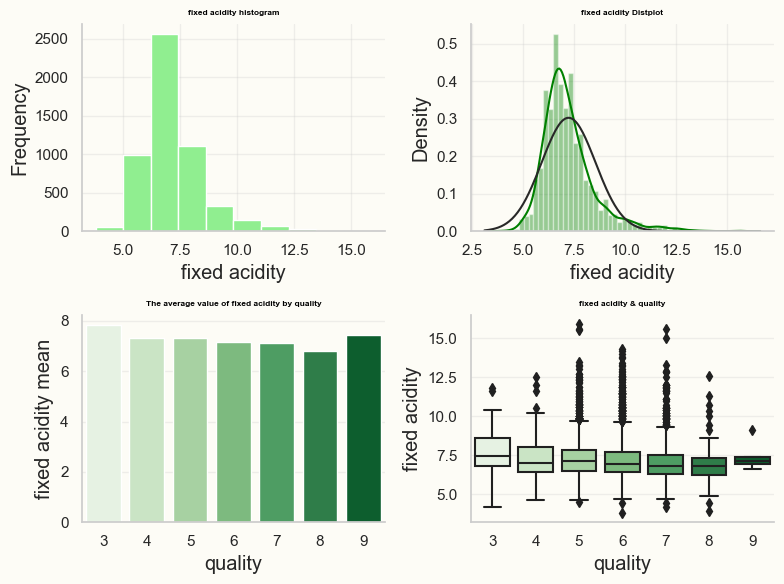

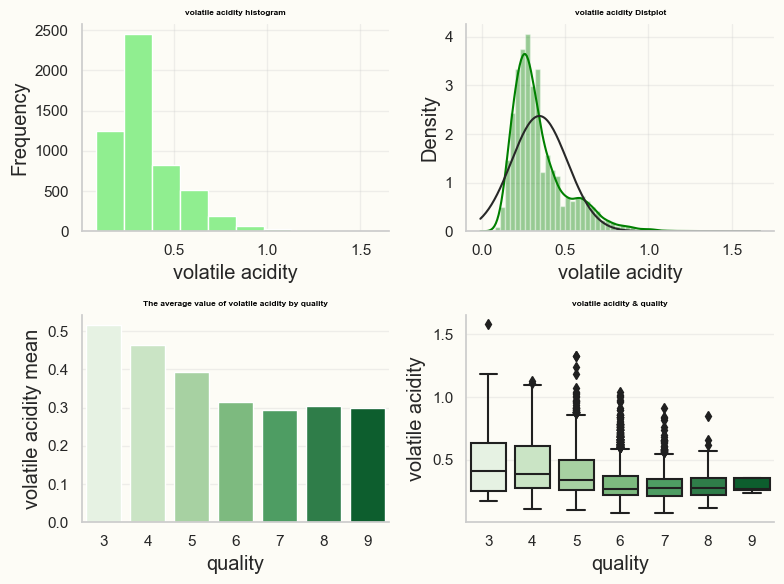

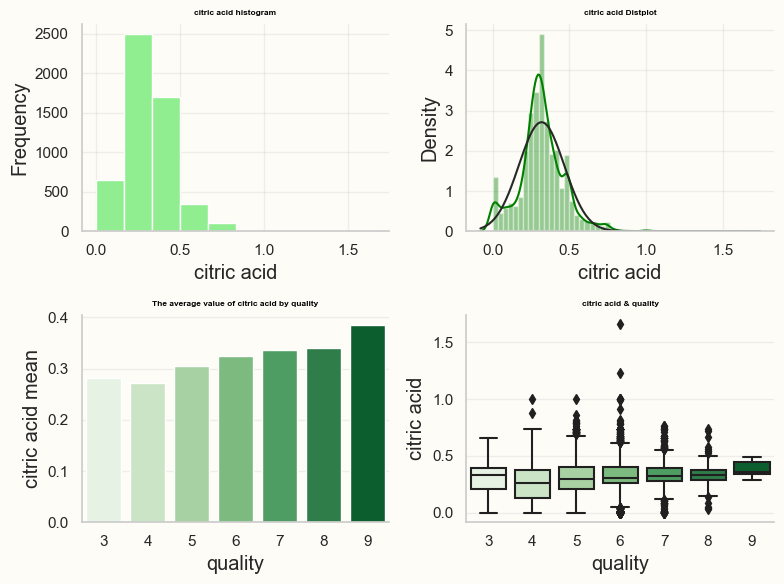

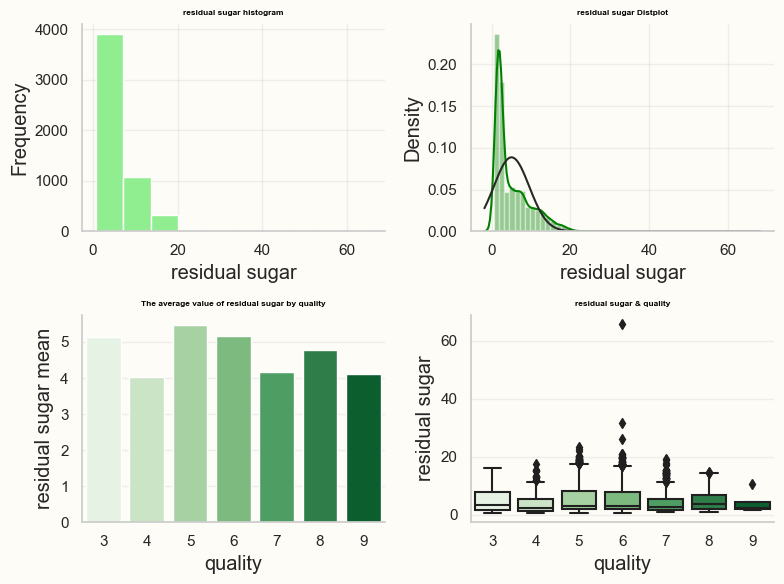

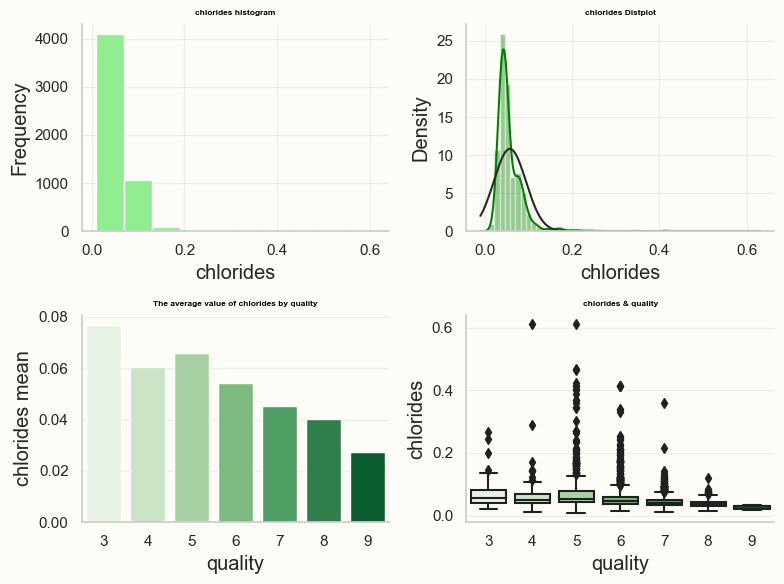

...

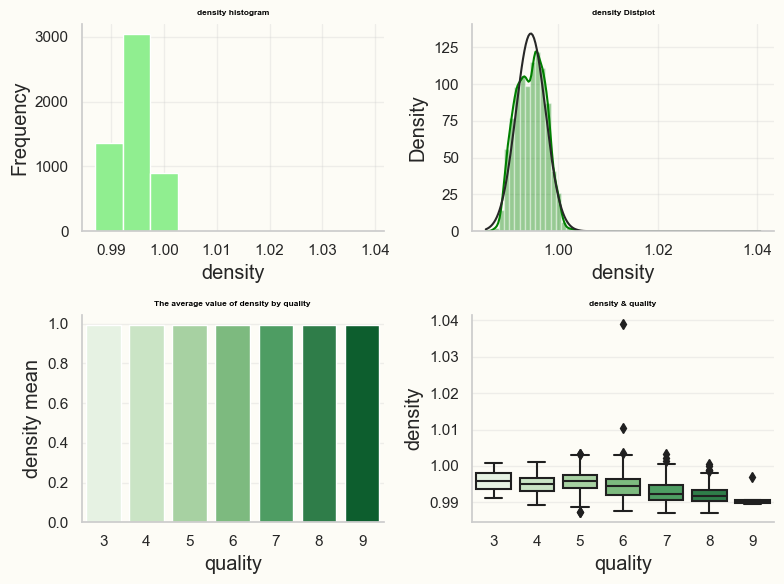

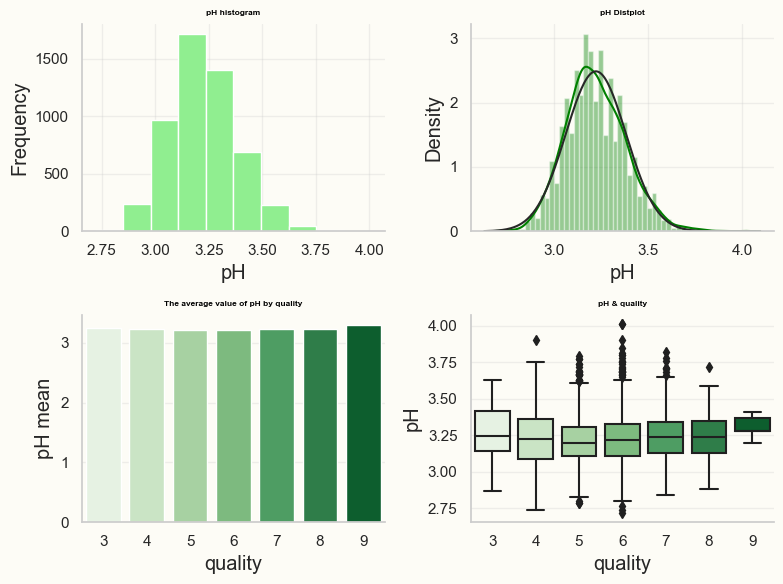

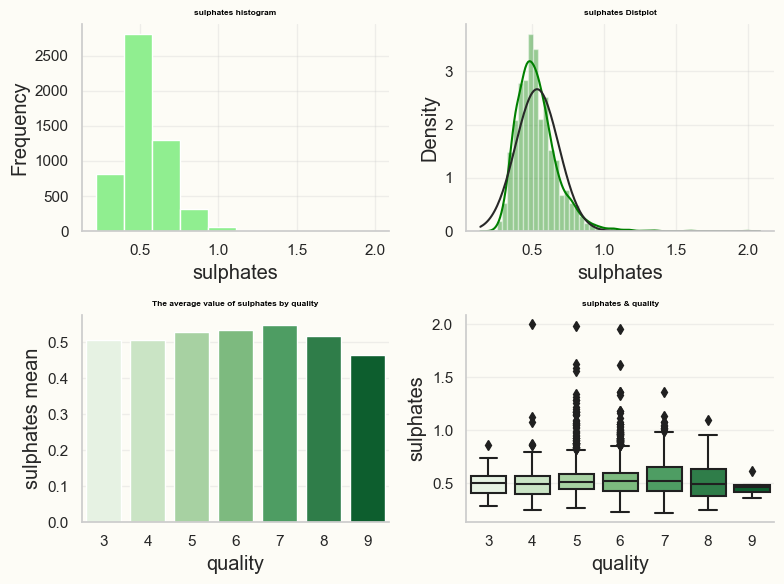

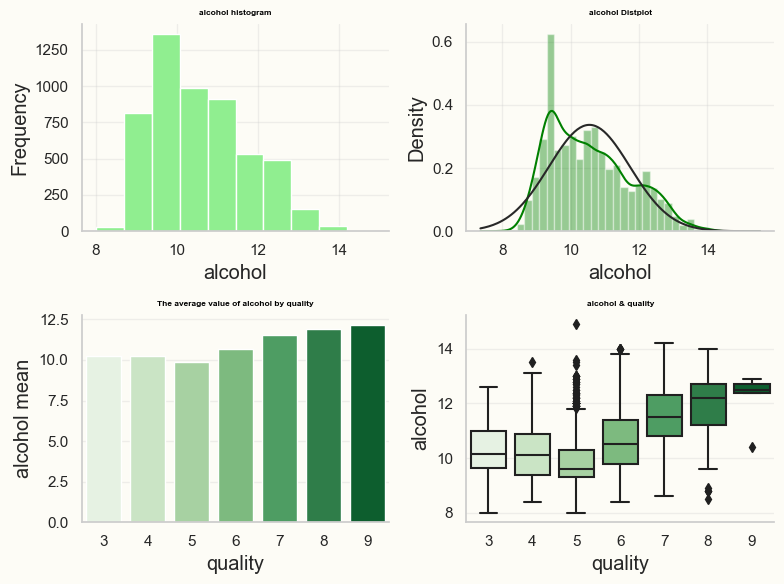

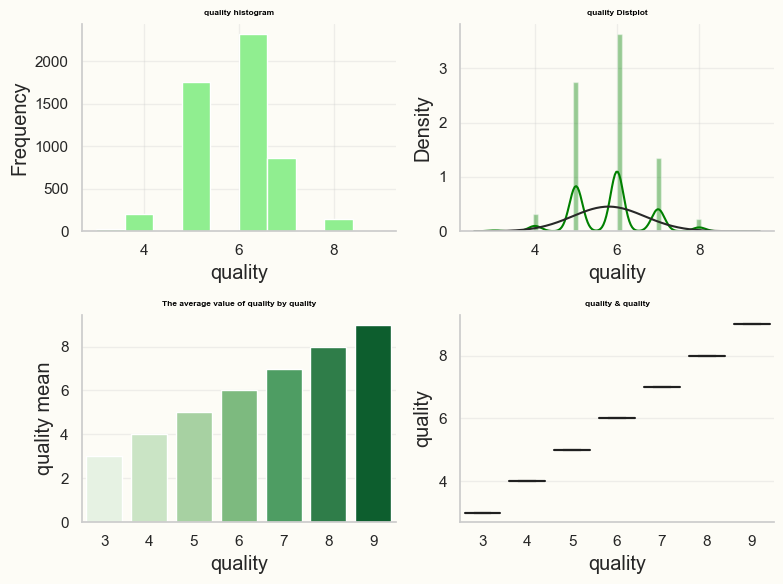

In [18]:
for col in df.drop('class', axis=1):
    plot_analysis(df.drop('class', axis=1), 'quality', col)

## Análisis Bivariante

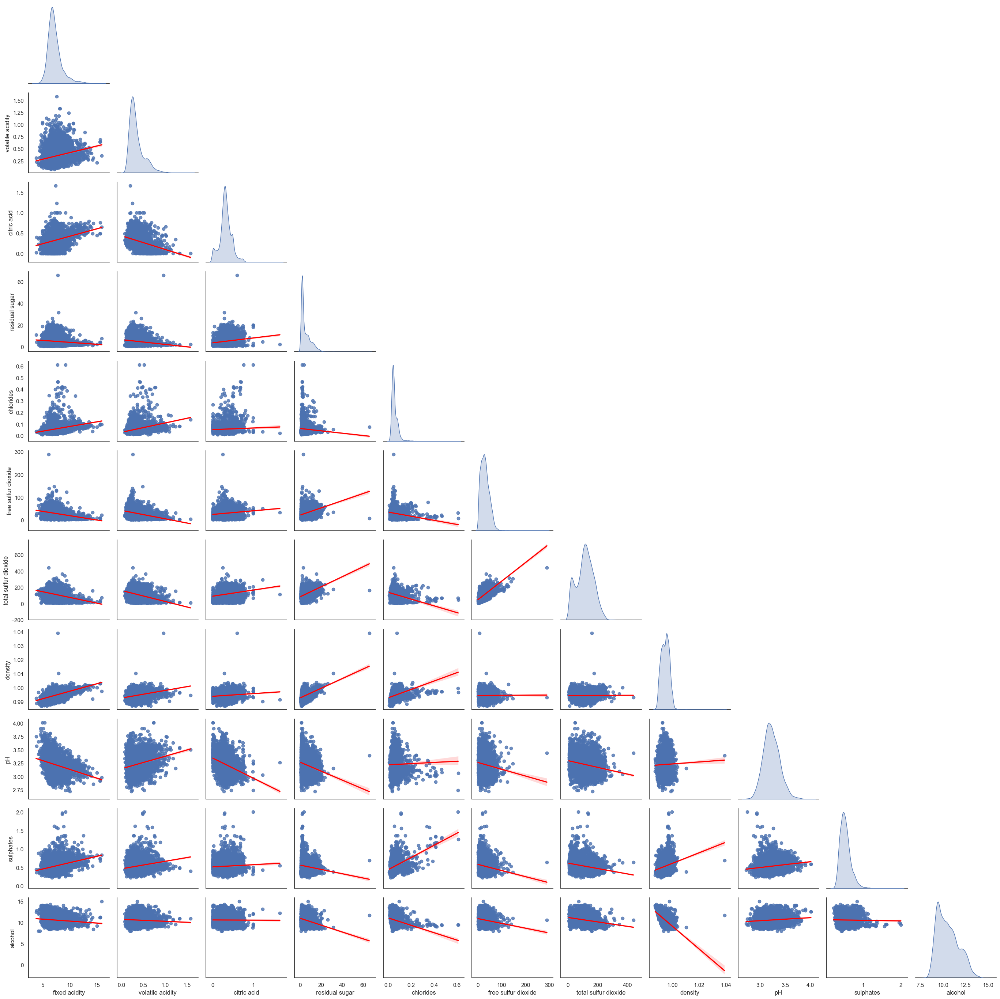

In [19]:

sns.set_theme(style='white')
sns.pairplot(df.drop(columns=['quality']),kind="reg",diag_kind='kde',plot_kws={'line_kws':{'color':'red'}},corner=True)
plt.tight_layout()
plt.show()

In [20]:
target=df[['quality']].value_counts(normalize=True).sort_index().round(decimals=3)*100
fig=go.Figure()
fig.add_trace(go.Pie(labels=target.index, values=target, hole=.5, 
                     showlegend=True,sort=False, 
                     marker=dict(colors=colors,line=dict(color='black',width=2.5)),
                     hovertemplate = "%{label} Transported: %{value:.2f}%<extra></extra>"))
fig.update_layout( title='Calidad del vino')
fig.show()

In [21]:
df['class'].unique()

array(['white', 'red'], dtype=object)

In [22]:
dfw=df[df['class']=='white'].drop('class',axis=1)
dfr=df[df['class']=='red'].drop('class', axis=1)
dfwr=df.drop('class', axis=1)

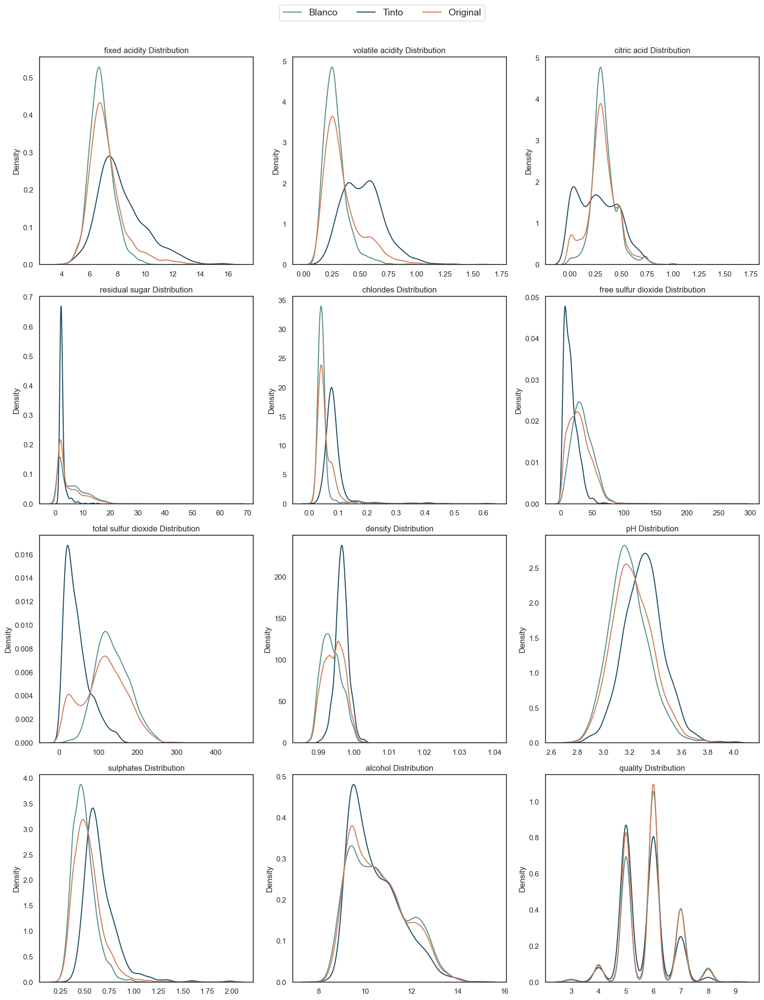

In [23]:
n_bins = 50
histplot_hyperparams = {
    'kde':True,
    'alpha':0.4,
    'stat':'percent',
    'bins':n_bins
}

columns = dfwr.columns
n_cols = 3
n_rows = math.ceil(len(columns)/n_cols)
fig, ax = plt.subplots(n_rows, n_cols, figsize=(16, n_rows*5))
ax = ax.flatten()

for i, column in enumerate(columns):
    plot_axes = [ax[i]]
    
    sns.kdeplot(
        dfw[column], label='Blanco',
        ax=ax[i], color=colors[1]
    )
    
    sns.kdeplot(
        dfr[column], label='Tinto',
        ax=ax[i], color=colors[2]
    )
    
    sns.kdeplot(
        dfwr[column], label='Original',
        ax=ax[i], color=colors[3]
    )
    
    # titles
    ax[i].set_title(f'{column} Distribution');
    ax[i].set_xlabel(None)
    
    # remove axes to show only one at the end
    plot_axes = [ax[i]]
    handles = []
    labels = []
    for plot_ax in plot_axes:
        handles += plot_ax.get_legend_handles_labels()[0]
        labels += plot_ax.get_legend_handles_labels()[1]
        plot_ax.legend().remove()
    
for i in range(i+1, len(ax)):
    ax[i].axis('off')

fig.legend(handles, labels, loc='upper center', bbox_to_anchor=(0.5, 1.04), fontsize=14, ncol=3)
plt.tight_layout()

Son distribuciones distintas. Se estudian por separado y luego se concatenan

# Proceso: Transformación - Escalado - Outliners - Desbalanceado

In [24]:
df = reduce_memory_usage(df, verbose=True)

Mem. usage decreased to 0.20 Mb (65.2% reduction)


In [25]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, FunctionTransformer
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
import numpy as np
import pandas as pd
from scipy.stats import skew, kurtosis
from scipy.stats import shapiro

# Funciones para la transformación de las características numéricas
def sqrt_transform(X):
    return np.sqrt(X)

def log_transform(X):
    return np.log1p(X)
def classify_distributions(df, threshold=0.05):
    """
    Clasifica las distribuciones de las columnas numéricas del DataFrame en una de las siguientes categorías:
    - 'normal': si la distribución se ajusta a una distribución normal según el test de Shapiro-Wilk.
    - 'positive_increasing': si la distribución es estrictamente creciente positiva.
    - 'positive_decreasing': si la distribución es estrictamente decreciente positiva.
    - 'rectangular': si la distribución es rectangular.
    - 'skewed_left': si la distribución tiene sesgo a la izquierda.
    - 'skewed_right': si la distribución tiene sesgo a la derecha.
    - 'bimodal': si la distribución tiene dos modas.
    - 'trimodal': si la distribución tiene tres modas.
    - 'polimodal': si la distribución tiene más de tres modas.
    - 'other': si no encaja en ninguna de las categorías anteriores.
    
    Parameters:
    - df: DataFrame. El DataFrame que contiene las características.
    - threshold: float. Umbral para clasificar la distribución como normal según el test de Shapiro-Wilk.

    Returns:
    - dist_class: dict. Un diccionario que mapea el nombre de cada columna con una tupla que contiene
                  el tipo de distribución y el nombre de la transformación propuesta.
    """
    # Seleccionar solo las columnas numéricas
    numeric_cols = df.select_dtypes(include=['number']).columns

    dist_class = {}

    for col in numeric_cols:
        data = df[col].dropna()
        _, p_value = shapiro(data)

        # Comprobar si todos los valores son positivos
        all_positive = all(x > 0 for x in data)
        
        if p_value > threshold:
            dist_class[col] = ('normal', None)
        else:
            # Calcular sesgo y curtosis
            skewness = skew(data)
            kurt = kurtosis(data)

            # Clasificar distribuciones
            if skewness > 0 and kurt > 0 and all_positive:
                dist_class[col] = ('positive_increasing', 'sqrt')
            elif skewness < 0 and kurt > 0 and all_positive:
                dist_class[col] = ('positive_decreasing', 'log')
            elif skewness > 0 and kurt < 0 and all_positive:
                dist_class[col] = ('skewed_right', 'yeo-johnson')
            elif skewness < 0 and kurt < 0 and all_positive:
                dist_class[col] = ('skewed_left', 'yeo-johnson')
            elif skewness == 0 and kurt == 0:
                dist_class[col] = ('rectangular', None)
            elif skewness == 0 and kurt > 0:
                dist_class[col] = ('rectangular', None)
            elif skewness == 0 and kurt < 0:
                dist_class[col] = ('rectangular', None)
            else:
                # Clasificar distribuciones multimodales
                modes = len(pd.Series(data).mode())
                if modes == 2:
                    dist_class[col] = ('bimodal', 'yeo-johnson')
                elif modes == 3:
                    dist_class[col] = ('trimodal', 'yeo-johnson')
                elif modes > 3:
                    dist_class[col] = ('polimodal', 'yeo-johnson')
                else:
                    dist_class[col] = ('other', None)

    return dist_class


In [26]:
classify_distributions(dfw, threshold=0.05)

{'fixed acidity': ('positive_increasing', 'sqrt'),
 'volatile acidity': ('positive_increasing', 'sqrt'),
 'citric acid': ('other', None),
 'residual sugar': ('positive_increasing', 'sqrt'),
 'chlorides': ('positive_increasing', 'sqrt'),
 'free sulfur dioxide': ('positive_increasing', 'sqrt'),
 'total sulfur dioxide': ('positive_increasing', 'sqrt'),
 'density': ('positive_increasing', 'sqrt'),
 'pH': ('positive_increasing', 'sqrt'),
 'sulphates': ('positive_increasing', 'sqrt'),
 'alcohol': ('skewed_right', 'yeo-johnson'),
 'quality': ('positive_increasing', 'sqrt')}

In [27]:
classify_distributions(dfr, threshold=0.05)

{'fixed acidity': ('positive_increasing', 'sqrt'),
 'volatile acidity': ('positive_increasing', 'sqrt'),
 'citric acid': ('other', None),
 'residual sugar': ('positive_increasing', 'sqrt'),
 'chlorides': ('positive_increasing', 'sqrt'),
 'free sulfur dioxide': ('positive_increasing', 'sqrt'),
 'total sulfur dioxide': ('positive_increasing', 'sqrt'),
 'density': ('positive_increasing', 'sqrt'),
 'pH': ('positive_increasing', 'sqrt'),
 'sulphates': ('positive_increasing', 'sqrt'),
 'alcohol': ('positive_increasing', 'sqrt'),
 'quality': ('positive_increasing', 'sqrt')}

In [28]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, FunctionTransformer, PowerTransformer
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split

# Funciones para la transformación de las características numéricas
def sqrt_transform(X):
    return np.sqrt(X)

def log_transform(X):
    return np.log1p(X)


In [29]:
def pipl_PCA_SMOTE_SPLIT(df, target_col, test_size=0.2, pca_n_components=0.95, threshold=0.05, smote_neighbors=3):
    dist_class = classify_distributions(df.drop(columns=[target_col]), threshold)
    categorical_columns = list(df.select_dtypes(include=['object']).columns)

    if categorical_columns:
        categorical_pipeline = Pipeline([
            ('onehot', OneHotEncoder())
        ])
    else:
        categorical_pipeline = None

    numeric_pipeline = Pipeline([
        ('transformation', ColumnTransformer([
            ('sqrt_transform', FunctionTransformer(sqrt_transform), [col for col, (dist, _) in dist_class.items() if dist == 'positive_increasing']),
            ('log_transform', FunctionTransformer(log_transform), [col for col, (dist, _) in dist_class.items() if dist == 'positive_decreasing']),
            ('yeojohnson_transform', PowerTransformer(method='yeo-johnson'), [col for col, (dist, _) in dist_class.items() if dist not in ['positive_increasing', 'positive_decreasing']])
        ], remainder='passthrough')),
        ('scaler', StandardScaler()),
        ('pca', PCA(n_components=pca_n_components))
    ])

    if categorical_pipeline:
        preprocessor = ColumnTransformer([
            ('categorical', categorical_pipeline, categorical_columns),
            ('numeric', numeric_pipeline, [col for col, _ in dist_class.items()])
        ])
    else:
        preprocessor = numeric_pipeline

    final_pipeline = Pipeline([
        ('preprocessor', preprocessor)
    ])

    X = df.drop(columns=[target_col])
    y = df[target_col]

    required_columns = set([col for col, _ in dist_class.items()])
    if not required_columns.issubset(X.columns):
        missing_columns = required_columns - set(X.columns)
        raise ValueError(f"Missing columns: {missing_columns}")

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=123)

    X_train_preprocessed = final_pipeline.fit_transform(X_train)
    X_test_preprocessed = final_pipeline.transform(X_test)

    smote = SMOTE(k_neighbors=smote_neighbors)
    X_train_resampled, y_train_resampled = smote.fit_resample(X_train_preprocessed, y_train)

    X_train_split, X_val, y_train_split, y_val = train_test_split(X_train_resampled, y_train_resampled, test_size=0.2, random_state=123)

    return X_train_split, X_val, X_test_preprocessed, y_train_split, y_val, y_test







In [30]:
target='quality'

In [31]:
X_trainw, X_valw,Xtest_setw , y_trainw, y_valw,ytest_setw=pipl_PCA_SMOTE_SPLIT(dfw, target, test_size=0.2, pca_n_components=0.95, threshold=0.05)
X_trainr, X_valr,Xtest_setr , y_trainr, y_valr,ytest_setr=pipl_PCA_SMOTE_SPLIT(dfr, target, test_size=0.2, pca_n_components=0.95, threshold=0.05)


### #2 Modelado para clasificación

Crea un modelo que permita clasificar lo mejor posible los vinos en función de su calidad, o dicho de otro modo que prediga de la mejor manera posible la calidad de un vino a partir de sus propiedades químicas. ***Considéralo un problema de clasificación***, donde los valores de calidad son las clases a predecir. Puedes utilizar los modelos que creas conveniente. Intenta mejorar el "recall medio" con las técnicas que creas conveniente. Compara los modelos utilizando validación cruzada con o sin optimización previa de hiperparámetros. El modelo elegido si tiene que tener un ejemplo de optimización de parámetros.

Evalúa el modelo, analiza los errores y propón algún mecanismo de mejora.

### Base Lines (Cross-Validation)

In [32]:
# Modelos de Clasificación
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier, RandomForestClassifier, GradientBoostingClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier



In [33]:

# Definir los modelos a comparar
modelos = {
    'Logistic Regression': LogisticRegression(solver='liblinear'),
    'DecisionTreeClassifier': DecisionTreeClassifier(),
    'Support Vector Machine': SVC(gamma='scale', probability=True),
    'Naive Bayes': GaussianNB(),
    'KNeighborsClassifier': KNeighborsClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'Bagging': BaggingClassifier(n_estimators=10),
    'Extra Trees': ExtraTreesClassifier(n_estimators=10),
    'XGBoost': XGBClassifier(),
    'Random Forest':RandomForestClassifier(n_estimators=10),
    'AdaBoost': AdaBoostClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'LightGBM':LGBMClassifier(),
}


In [34]:
# Definir los modelos a comparar
modelos = {
    'Logistic Regression': LogisticRegression(solver='liblinear'),
    'DecisionTreeClassifier': DecisionTreeClassifier(),
    'Support Vector Machine': SVC(gamma='scale', probability=True),
    'Naive Bayes': GaussianNB(),
    'KNeighborsClassifier': KNeighborsClassifier(),
    'AdaBoost': AdaBoostClassifier(),
    'Bagging': BaggingClassifier(n_estimators=10),
    'Extra Trees': ExtraTreesClassifier(n_estimators=10),
    'Random Forest':RandomForestClassifier(n_estimators=10),
    'AdaBoost': AdaBoostClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'LightGBM':LGBMClassifier(),
}


In [40]:
from sklearn.model_selection import StratifiedKFold,cross_val_score

def perform_cross_validation(models, x_train, y_train, n_splits=8, random_state=42,metric='accuracy'):
    kfold = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=random_state)
    
    cv_results = []
    for name, model in models.items():
        cv_results.append(cross_val_score(model, x_train, y_train, scoring=metric, cv=kfold, n_jobs=-1))
    
    cv_means = [cv_result.mean() for cv_result in cv_results]
    cv_std = [cv_result.std() for cv_result in cv_results]
    
    cv_df = pd.DataFrame({"CrossVal_Score_Means": cv_means, "CrossValerrors": cv_std, "Algo": list(models.keys())})
    
    plt.figure(figsize=(10, 7))
    g = sns.barplot(x="CrossVal_Score_Means", y="Algo", data=cv_df, orient="h", palette='cool', 
                    edgecolor="black", linewidth=3)
    g.set_xlabel("Mean Accuracy", fontsize=18)
    g.set_title("Cross validation scores", fontsize=24)
    plt.show()
    
    return cv_df


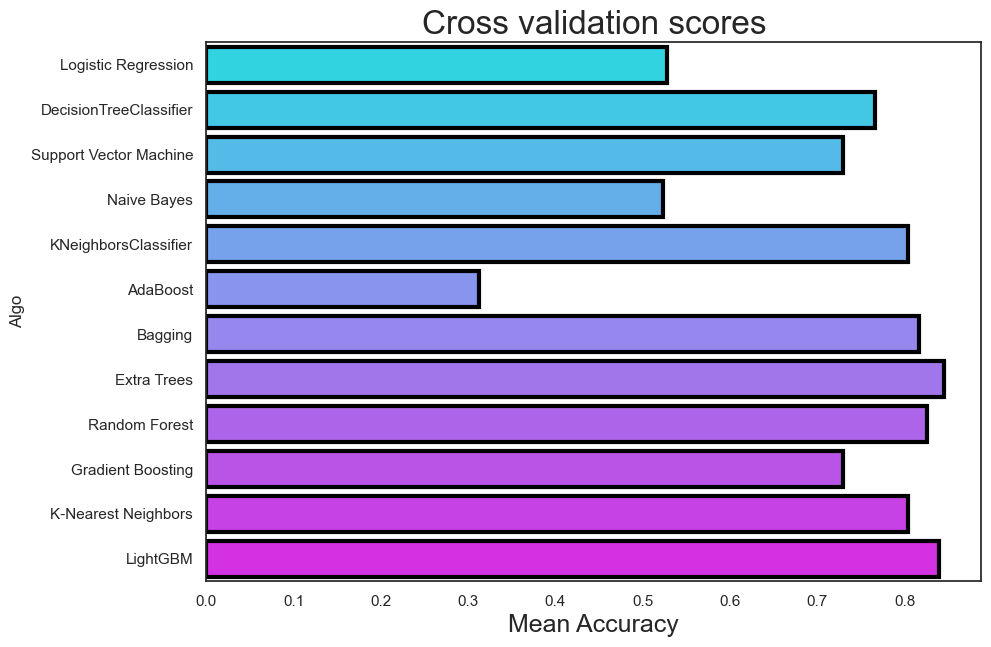

Vinos Blancos     CrossVal_Score_Means  CrossValerrors                    Algo
0               0.527998        0.011702     Logistic Regression
1               0.765898        0.012766  DecisionTreeClassifier
2               0.729246        0.008859  Support Vector Machine
3               0.522836        0.006364             Naive Bayes
4               0.803785        0.008252    KNeighborsClassifier
5               0.312945        0.026806                AdaBoost
6               0.816374        0.010293                 Bagging
7               0.845709        0.008295             Extra Trees
8               0.825539        0.006095           Random Forest
9               0.729603        0.007314       Gradient Boosting
10              0.803785        0.008252     K-Nearest Neighbors
11              0.839256        0.011503                LightGBM


In [41]:
# Llamar a la función con el diccionario de modelos y los datos de entrenamiento
cv_df_w = perform_cross_validation(modelos, X_trainw, y_trainw, metric="recall_macro")
print('Vinos Blancos',cv_df_w)



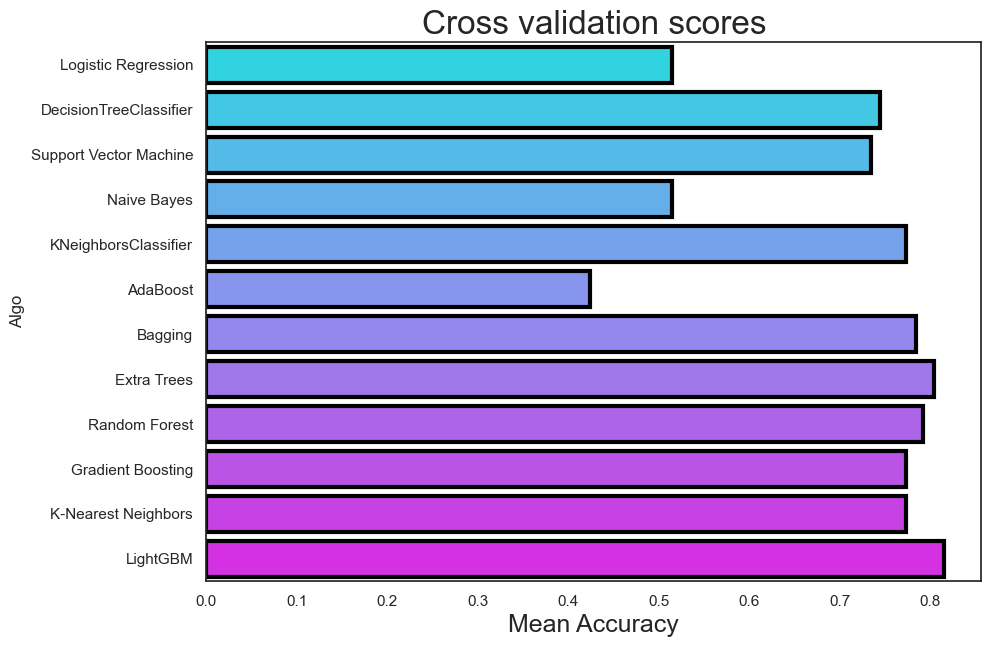

Vinos Tintos     CrossVal_Score_Means  CrossValerrors                    Algo
0               0.515282        0.025339     Logistic Regression
1               0.744409        0.018592  DecisionTreeClassifier
2               0.734285        0.018647  Support Vector Machine
3               0.514377        0.032521             Naive Bayes
4               0.772971        0.019541    KNeighborsClassifier
5               0.423572        0.019340                AdaBoost
6               0.784998        0.026444                 Bagging
7               0.804132        0.023033             Extra Trees
8               0.791723        0.031339           Random Forest
9               0.773822        0.020232       Gradient Boosting
10              0.772971        0.019541     K-Nearest Neighbors
11              0.815940        0.018444                LightGBM


In [43]:
cv_df_r = perform_cross_validation(modelos, X_trainr, y_trainr,metric="recall_macro")
print('Vinos Tintos',cv_df_r)


In [44]:
# top 3 models from cv_df_w
top_3_models_w = cv_df_w.nlargest(3, 'CrossVal_Score_Means')['Algo'].tolist()
top_3_models_w

['Extra Trees', 'LightGBM', 'Random Forest']

In [45]:
# top 3 models from cv_df_r
top_3_models_r = cv_df_r.nlargest(3, 'CrossVal_Score_Means')['Algo'].tolist()
top_3_models_r

['LightGBM', 'Extra Trees', 'Random Forest']

#### Los modelos son los mismos

# Fine tuning models

In [49]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform, randint


In [50]:
def hyperparameter_tuning(models, X, y):
    # Almacena los resultados en un DataFrame
    results = []

    # Loop sobre los modelos
    for model_name, config in models.items():
        print(f"Tuning hyperparameters for {model_name}")
        model = RandomizedSearchCV(config["model"], config["params"], n_iter=50, cv=5, verbose=2, random_state=42)
        model.fit(X, y)  # Ajusta el modelo con los datos de entrenamiento
        best_params = model.best_params_
        best_score = model.best_score_
        results.append([model_name, best_params, best_score])

    # Crear un DataFrame a partir de los resultados
    results_df = pd.DataFrame(results, columns=["Model", "Best Parameters", "Best Score"])

    return results_df

In [51]:
# Definir los modelos y los rangos de hiperparámetros a explorar
models = {
    "LightGBM": {
        "model": LGBMClassifier(),
        "params": {
            "n_estimators": randint(50, 200),
            "learning_rate": uniform(0.01, 0.3),
            "max_depth": [3, 4, 5, 6, 7, 8],
            "num_leaves": randint(20, 100),
            "min_child_samples": randint(2, 20)
        }
    },
    "Extra Trees": {
        "model": ExtraTreesClassifier(),
        "params": {
            "n_estimators": randint(50, 200),
            "max_depth": [None, 10, 20, 30, 40, 50],
            "min_samples_split": randint(2, 20),
            "min_samples_leaf": randint(1, 20),
            "max_features": ["auto", "sqrt", "log2"]
        }
    },
    "Random Forest": {
        "model": RandomForestClassifier(),
        "params": {
            "n_estimators": randint(50, 200),
            "max_depth": [None, 10, 20, 30, 40, 50],
            "min_samples_split": randint(2, 20),
            "min_samples_leaf": randint(1, 20),
            "max_features": ["auto", "sqrt", "log2"]
        }
    }
}


In [52]:
results_df_w = hyperparameter_tuning(models, X_trainw, y_trainw)

Tuning hyperparameters for LightGBM
Fitting 5 folds for each of 50 candidates, totalling 250 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005166 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2295
[LightGBM] [Info] Number of data points in the train set: 6356, number of used features: 9
[LightGBM] [Info] Start training from score -1.930609
[LightGBM] [Info] Start training from score -1.970438
[LightGBM] [Info] Start training from score -1.951432
[LightGBM] [Info] Start training from score -1.950325
[LightGBM] [Info] Start training from score -1.948115
[LightGBM] [Info] Start training from score -1.939324
[LightGBM] [Info] Start training from score -1.931694
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [

In [84]:
best_params_w=results_df_w.loc[results_df_w['Best Score']==max(results_df_w['Best Score']),'Best Parameters'].to_dict()[1]

In [91]:
best_params_w

{'max_depth': 40,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 3,
 'n_estimators': 102}

In [58]:
results_df_r=hyperparameter_tuning(models, X_trainr, y_trainr)

Tuning hyperparameters for LightGBM
Fitting 5 folds for each of 50 candidates, totalling 250 fits
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000418 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 1743, number of used features: 8
[LightGBM] [Info] Start training from score -1.800403
[LightGBM] [Info] Start training from score -1.814389
[LightGBM] [Info] Start training from score -1.810874
[LightGBM] [Info] Start training from score -1.776388
[LightGBM] [Info] Start training from score -1.776388
[LightGBM] [Info] Start training from score -1.773004
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

In [82]:
best_params_r=results_df_r.loc[results_df_r['Best Score']==max(results_df_r['Best Score']),'Best Parameters'].to_dict()[1]

In [90]:
best_params_r

{'max_depth': 40,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 3,
 'n_estimators': 102}

In [89]:
results_df_r

,Model,Best Parameters,Best Score
0,LightGBM,"{'learning_rate': 0.1212454756594799, 'max_dep...",0.820104
1,Extra Trees,"{'max_depth': 40, 'max_features': 'auto', 'min...",0.834797
2,Random Forest,"{'max_depth': 40, 'max_features': 'auto', 'min...",0.819192


In [60]:
# Save models as pickle in current directory
import pickle

def save_model(model, filename):
    with open(filename, 'wb') as f:
        pickle.dump(model, f)


In [ ]:
# Los modelos elegidos son:

In [94]:
best_params_r.to_dict()[1]

AttributeError: 'dict' object has no attribute 'to_dict'

In [93]:
model_white = ExtraTreesClassifier(
    max_depth=40,
    max_features='auto',
    min_samples_leaf=1,
    min_samples_split=3,
    n_estimators=102
)


In [95]:
model_red =  ExtraTreesClassifier(    max_depth=40,
    max_features='auto',
    min_samples_leaf=1,
    min_samples_split=3,
    n_estimators=102)

# Ensemble models

In [97]:
# Entrenar modelos distintos para cada tipo de vino
model_white.fit(X_trainw, y_trainw)
model_red.fit(X_trainr, y_trainr)

ExtraTreesClassifier(max_depth=40, max_features='auto', min_samples_split=3,
                     n_estimators=102)

In [98]:
save_model(model_white, 'model_white.pkl')
save_model(model_red, 'model_red.pkl')

In [106]:
pip install vecstack

  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for vecstack: filename=vecstack-0.4.0-py3-none-any.whl size=19875 sha256=d6276e804c1d29fbb583f3d589c43415a0441a2453fb3fe76e9bbf56f32d4b30
  Stored in directory: c:\users\0205301\appdata\local\pip\cache\wheels\88\3e\4b\a1a6ef703727d7f457db98b2a0b29fd3bd599c210d04639756
Successfully built vecstack
Note: you may need to restart the kernel to use updated packages.


In [115]:
import pandas as pd
from sklearn.metrics import accuracy_score, mean_squared_error
from sklearn.impute import SimpleImputer
from vecstack import StackingTransformer
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split

# Convertir arrays de NumPy en Series o DataFrame de Pandas para conjuntos de prueba
X_train_combined = pd.concat([pd.DataFrame(X_trainw), pd.DataFrame(X_trainr)])
y_train_combined = pd.concat([pd.Series(y_trainw), pd.Series(y_trainr)])
X_test_combined = pd.concat([pd.DataFrame(Xtest_setw), pd.DataFrame(Xtest_setr)])
y_test_combined = pd.concat([pd.Series(ytest_setw), pd.Series(ytest_setr)])

# Manejar valores faltantes en los datos de entrenamiento y prueba
imputer = SimpleImputer(strategy='mean')
X_train_combined = imputer.fit_transform(X_train_combined)
X_test_combined = imputer.transform(X_test_combined)

# Define tus modelos base
models = [('model_white',ExtraTreesClassifier(
    max_depth=40,
    max_features='auto',
    min_samples_leaf=1,
    min_samples_split=3,
    n_estimators=102
)
), ('model_red',ExtraTreesClassifier(
    max_depth=40,
    max_features='auto',
    min_samples_leaf=1,
    min_samples_split=3,
    n_estimators=102
)
)]


# Crea el StackingTransformer
stack = StackingTransformer(models, regression=False, shuffle=True, verbose=2)

# Ajusta el StackingTransformer a tus datos de entrenamiento
stack = stack.fit(X_train_combined, y_train_combined)

# Haz predicciones con el StackingTransformer
y_pred = stack.predict(X_test_combined)

# Calcular la precisión de las predicciones
accuracy = accuracy_score(y_test_combined, y_pred)
print("Accuracy:", accuracy)

# Evalúa el rendimiento del Super Learner
mse = mean_squared_error(y_test_combined, y_pred)
print("Mean Squared Error:", mse)


task:         [classification]
n_classes:    [7]
metric:       [accuracy_score]
variant:      [A]
n_estimators: [2]



ValueError: Setting a random_state has no effect since shuffle is False. You should leave random_state to its default (None), or set shuffle=True.

In [ ]:
def evaluate_on_validation_set(best_model, X_val, y_val):
    return best_model.score(X_val, y_val)

In [ ]:
for nombre_modelo,model in modelos_tuneados.items():
    print(nombre_modelo)
    clf = model
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_val)
    from sklearn.metrics import classification_report
    print(classification_report(y_val, y_pred))

ROC Curve and Area Under the Curve (AUC)

In [ ]:
validation_accuracy = evaluate_on_validation_set(best_model, X_val, y_val)
print(f"Accuracy on validation set for {best_model_name}: {validation_accuracy}")

In [ ]:
y_pred_proba = rfc.predict_proba(x_test)[:][:,1]

df_actual_predicted = pd.concat([pd.DataFrame(np.array(y_test), columns=["y_actual"])])
df_actual_predicted.index = y_test.index


fpr, tpr, thresholds = roc_curve(df_actual_predicted["y_actual"], y_pred_proba)
auc = roc_auc_score(df_actual_predicted["y_actual"], y_pred_proba)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"AUC = {auc:.2f}",color="green")
plt.plot([0, 1], [0, 1], linestyle="--", color="black")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve",pad=20,fontweight="black")
plt.legend()
plt.show()

## Análisis de overfitting

In [ ]:
#create the models
log_reg=LogisticRegression(penalty='none')
log_reg_l1=LogisticRegression(penalty='l1',solver='liblinear', max_iter=1000)
log_reg_l2=LogisticRegression(penalty='l2',max_iter=1000)
log_reg_elasticnet = SGDClassifier(loss='log', penalty='elasticnet', l1_ratio=0.5, max_iter=1000)

#fit the models

log_reg.fit(X_train, y_train)
log_reg_l1.fit(X_train, y_train)
log_reg_l2.fit(X_train, y_train)
log_reg_elasticnet.fit(X_train, y_train)

# Predict and evaluate accuracy for each model on both training and test sets
def evaluate_accuracy(model, X_train, y_train, X_test, y_test):
    train_acc = model.score(X_train, y_train)
    test_acc = model.score(X_test, y_test)
    return train_acc, test_acc

# Evaluate accuracy for each model on both training and test sets
log_reg_results = evaluate_accuracy(log_reg, X_train, y_train, X_test, y_test)
log_reg_l1_results = evaluate_accuracy(log_reg_l1, X_train, y_train, X_test, y_test)
log_reg_l2_results = evaluate_accuracy(log_reg_l2, X_train, y_train, X_test, y_test)
log_reg_elasticnet_results = evaluate_accuracy(log_reg_elasticnet, X_train, y_train, X_test, y_test)

log_reg_results, log_reg_l1_results, log_reg_l2_results, log_reg_elasticnet_results

## Calibrado

### #3 Modelado para regresión

Reutiliza todo lo que puedas la preparación del modelado de la parte anterior y construye ahora el mejor modelo que puedas para predecir el grado alcohólico de un vino dadas sus características fisico químicas, su clase y la puntuación de calidad que le ha sido otorgada. Compara los modelos, seleccionando una métrica adecuada de comparación y escoge el más apropiado empleando validación cruzada antes o después de optimizar hiperparámetros. Evalúa el modelo escogido y con los hiperparámetros ajustados de la mejor manera que puedas. Para terminar realizar un pequeño análisis de errores.

In [ ]:
#Mejor recall medio
# Posibles vinos =>MAPE